# Import Utils and Matplotlib params

In [2]:
import numpy as np
import rasterio
import matplotlib.pyplot as plt
import matplotlib.colors as clrs
import pandas as pd
from sklearn.mixture import GaussianMixture
import shutil
from astropy.visualization import ZScaleInterval
from scipy.stats import gaussian_kde
import plotly.express as px
import warnings

warnings.filterwarnings("ignore")

mlp_params = {
    "figure.figsize": [9, 6],
    "axes.labelsize": 22,
    "axes.titlesize": 24,
    "axes.titlepad": 15,
    "figure.titlesize": 24,
    "axes.labelpad": 10,
    "font.size": 16,
    "legend.fontsize": 18,
    "xtick.labelsize": 16,
    "ytick.labelsize": 16,
    "text.usetex": True if shutil.which("latex") else False,
    "font.family": "serif",
    "xtick.minor.visible": True,
    "ytick.minor.visible": True,
    "xtick.top": True,
    "ytick.left": True,
    "ytick.right": True,
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.minor.size": 2.5,
    "xtick.major.size": 5,
    "ytick.minor.size": 2.5,
    "ytick.major.size": 5,
    "axes.axisbelow": True,
    "figure.dpi": 200,
}
plt.rcParams.update(mlp_params)

base_image = "lroc_color_poles_4k.tif"
with rasterio.open(base_image) as src:
    base_data = np.stack([src.read(i + 1) for i in range(3)], axis=-1)

## Get Mg/Si, Al/Si and Fe/Si Data

Change the paths in the `get_data` function to import the appropriate TIFF files

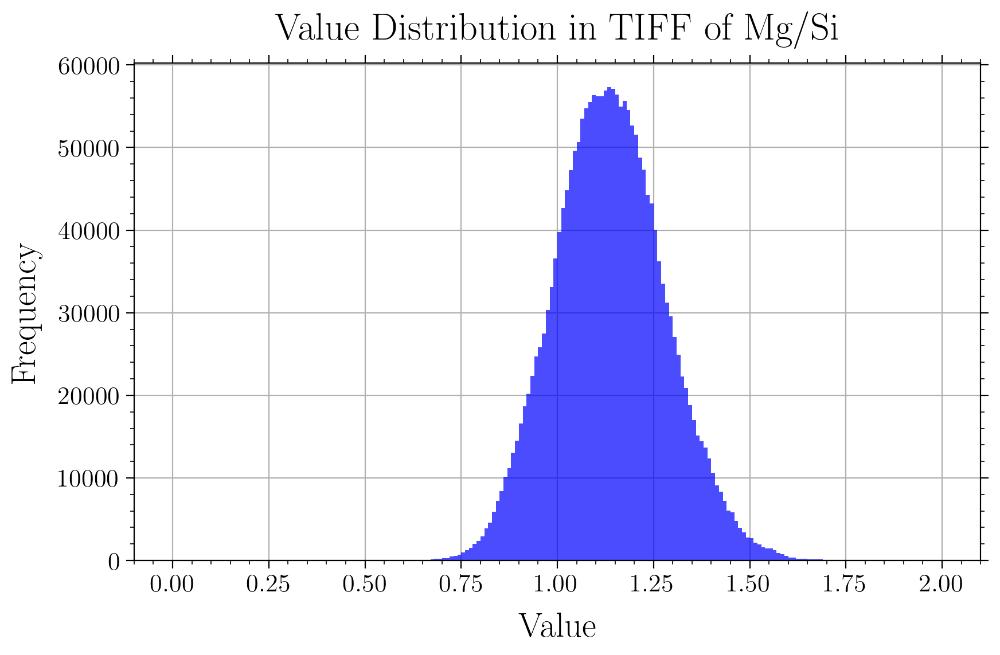

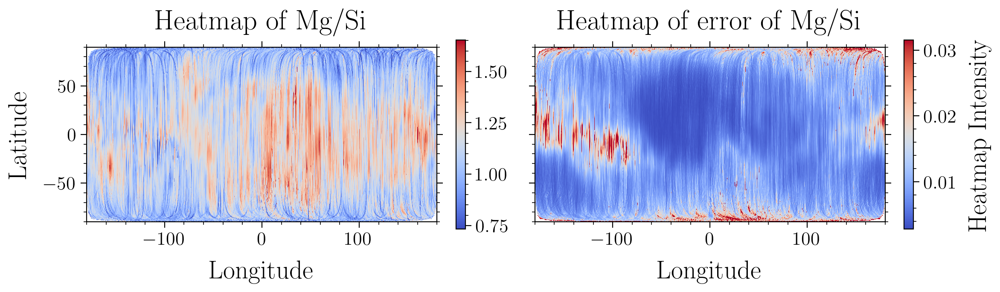

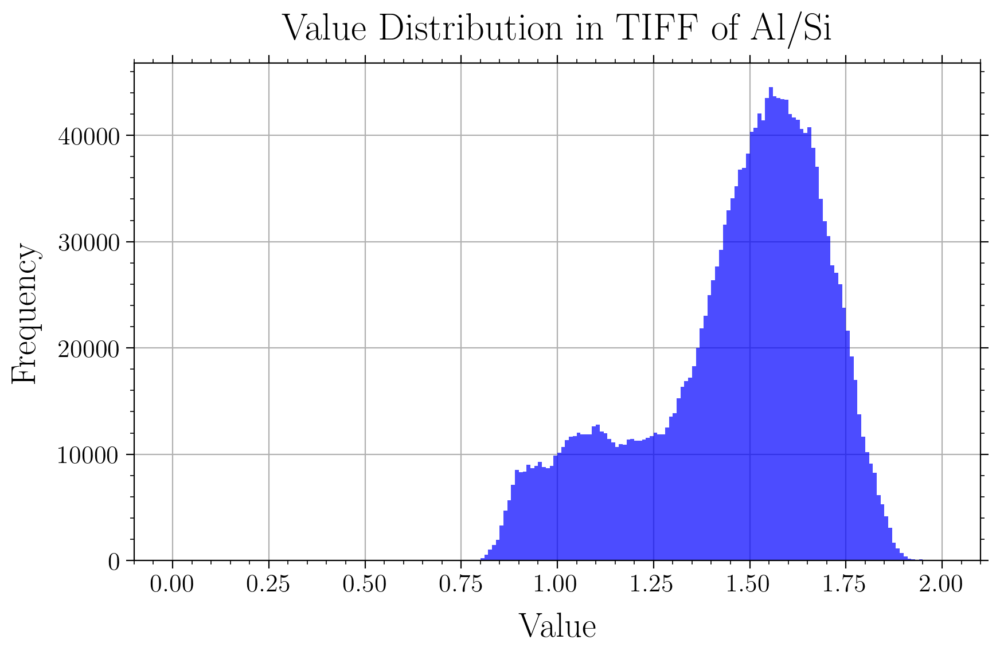

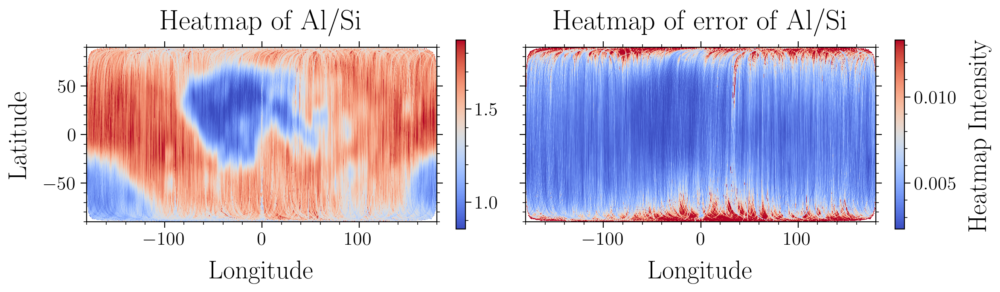

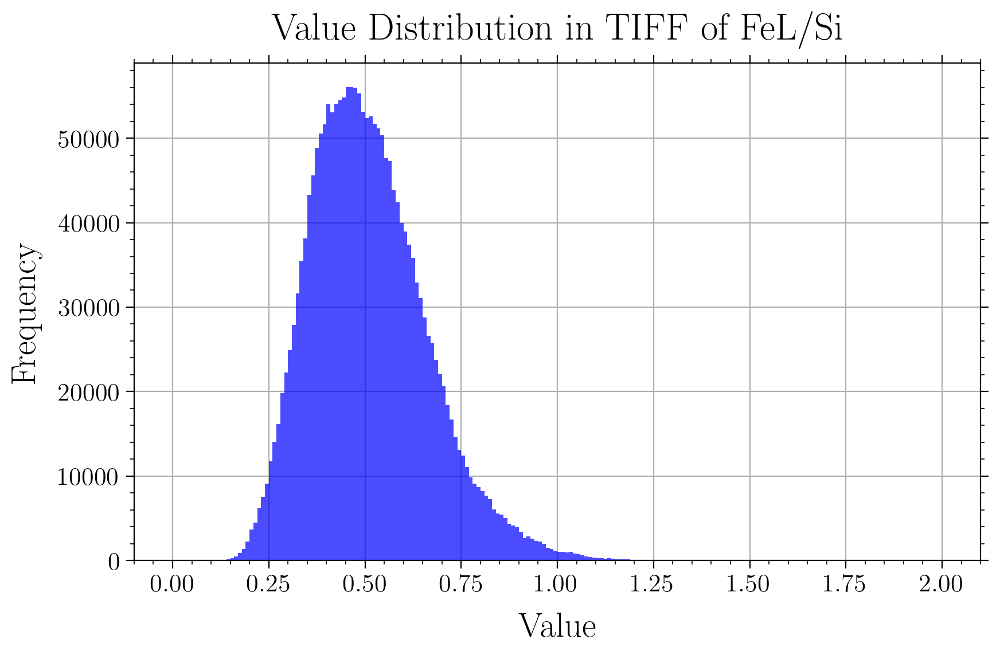

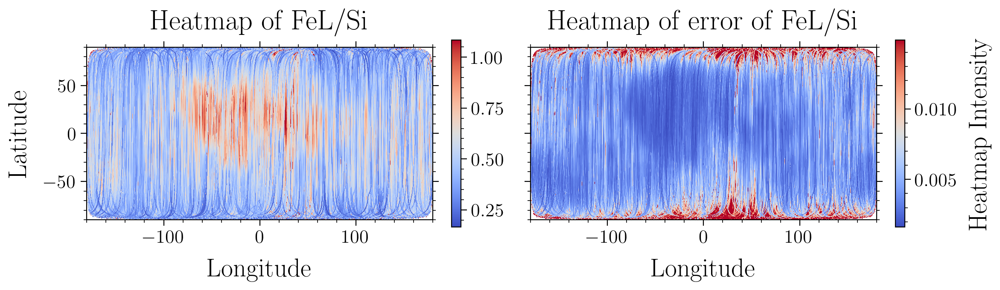

In [3]:
def get_data(elem, ref_elem):
    with rasterio.open(
        f"{elem}_{ref_elem}_combined.tiff"
    ) as src:
        data = src.read(1)
        err = src.read(2)
        nodata_val = 9999
    data = np.copy(data)
    err = np.copy(err)
    data = np.ma.masked_equal(data, nodata_val)
    err = np.ma.masked_equal(err, nodata_val)
    plt.hist(data.flatten(), bins=200, color="blue", alpha=0.7, range=(0, 2))
    plt.title(f"Value Distribution in TIFF of {elem}/{ref_elem}")
    plt.xlabel("Value")
    plt.ylabel("Frequency")
    plt.grid()
    plt.tight_layout()
    plt.show()

    zmin, zmax = ZScaleInterval().get_limits(data[~data.mask])

    fig, axs = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

    plt.subplot(1, 2, 1)
    plt.imshow(
        data,
        extent=(-180, 180, -90, 90),
        cmap="coolwarm",  # Ensure the same extent as the base layer
        interpolation="nearest",
        alpha=1,  # Adjust opacity for overlay
        vmin=zmin,
        vmax=zmax,
    )

    zmin, zmax = ZScaleInterval().get_limits(err[~err.mask])

    plt.colorbar(fraction=0.025, pad=0.05)
    plt.title(f"Heatmap of {elem}/{ref_elem}")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")

    plt.subplot(1, 2, 2)
    plt.imshow(
        err,
        extent=(-180, 180, -90, 90),
        cmap="coolwarm",  # Ensure the same extent as the base layer
        interpolation="nearest",
        alpha=1,  # Adjust opacity for overlay
        vmin=zmin,
        vmax=zmax,
    )

    plt.colorbar(label="Heatmap Intensity", fraction=0.025, pad=0.05)
    plt.title(f"Heatmap of error of {elem}/{ref_elem}")
    plt.xlabel("Longitude")

    plt.tight_layout()
    plt.show()
    return data, err


data_mg, err_mg = get_data("Mg", "Si")
data_al, err_al = get_data("Al", "Si")
data_fel, err_fel = get_data("FeL", "Si")

# et up lon-lat grid
n_lat, n_lon = data_mg.shape

lons = np.linspace(-180, 180, n_lon)  # Longitude from -180 to 180
lats = np.linspace(90, -90, n_lat)  # Latitude from 90 to -90 (inverted)
lons_grid, lats_grid = np.meshgrid(lons, lats)

lat_flat = lats_grid.flatten()
lon_flat = lons_grid.flatten()

mg_flat = data_mg.flatten()
al_flat = data_al.flatten()
fel_flat = data_fel.flatten()

df = pd.DataFrame(
    {
        "latitude": lat_flat,
        "longitude": lon_flat,
        "Mg_ratio": mg_flat,
        "Al_ratio": al_flat,
        "FeL_ratio": fel_flat,
        "Mg_num": (mg_flat / (mg_flat + fel_flat)),
    }
)
df = df[df["Mg_ratio"] != 9999.0]
df = df[df["Al_ratio"] != 9999.0]
df = df[df["FeL_ratio"] != 9999.0]
df = df[abs(df["latitude"]) < 60]
df.dropna(inplace=True)

## Heatmap of Mg number

Mg number is defined as $\dfrac{\text{MgO}}{\text{MgO} + \text{FeO}}$ in terms of abundances. We map a ratio similar to this in terms of the Mg/Si and Fe/Si flux ratios, by making a heatmap of $\dfrac{\text{Mg}/\text{Si}}{\text{Mg}/\text{Si} + \text{Fe}/\text{Si}}$. The maria and highland contrast is faintly observed in this heatmap.

We will observe in later sections that clusters made by comparing the Mg number VS Al/Si ratio is good at extracting geographical features.

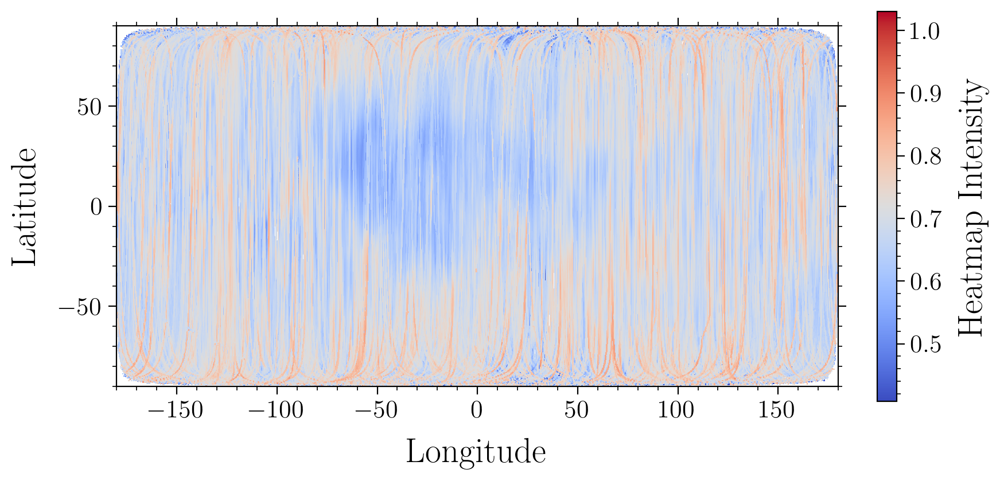

In [4]:
zmin, zmax = ZScaleInterval().get_limits(data_mg / (data_mg + data_fel))
plt.imshow(
    data_mg / (data_mg + data_fel),
    extent=(-180, 180, -90, 90),
    cmap="coolwarm",  # Ensure the same extent as the base layer
    interpolation="nearest",
    alpha=1,  # Adjust opacity for overlay
    vmin=zmin,
    vmax=zmax,
)

plt.colorbar(label="Heatmap Intensity", fraction=0.025, pad=0.05)
plt.ylabel("Latitude")
plt.xlabel("Longitude")
plt.tight_layout()
plt.show()

## Scatter plot of Mg number vs Al/Si

In [5]:
sample_size = 200000
sampled_df = df.sample(sample_size)

[[1.0585864  0.64556724]
 [1.6695161  0.69312954]
 [1.4723637  0.70531297]]
R^2 = 0.1249220364993694


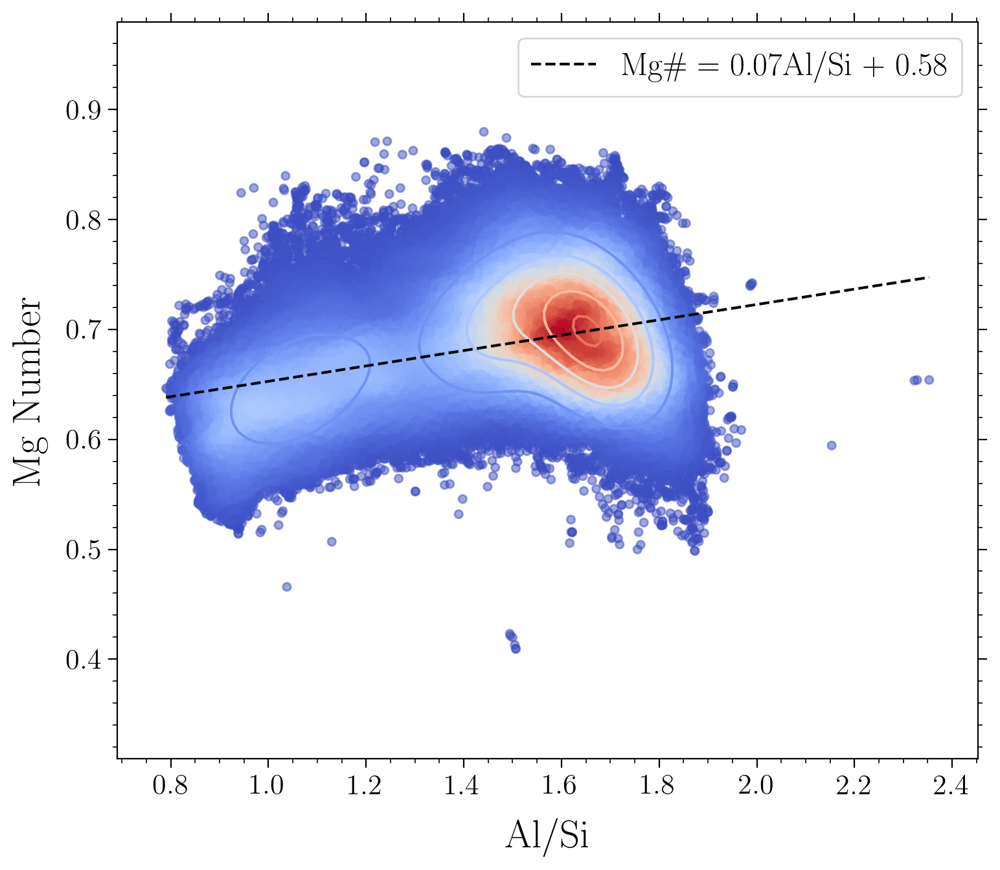

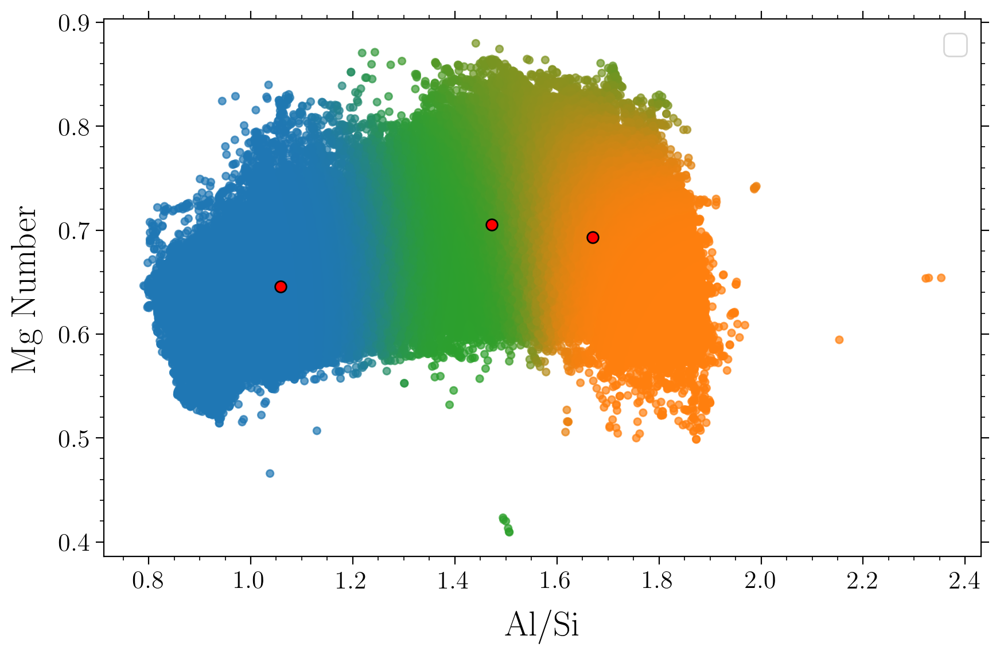

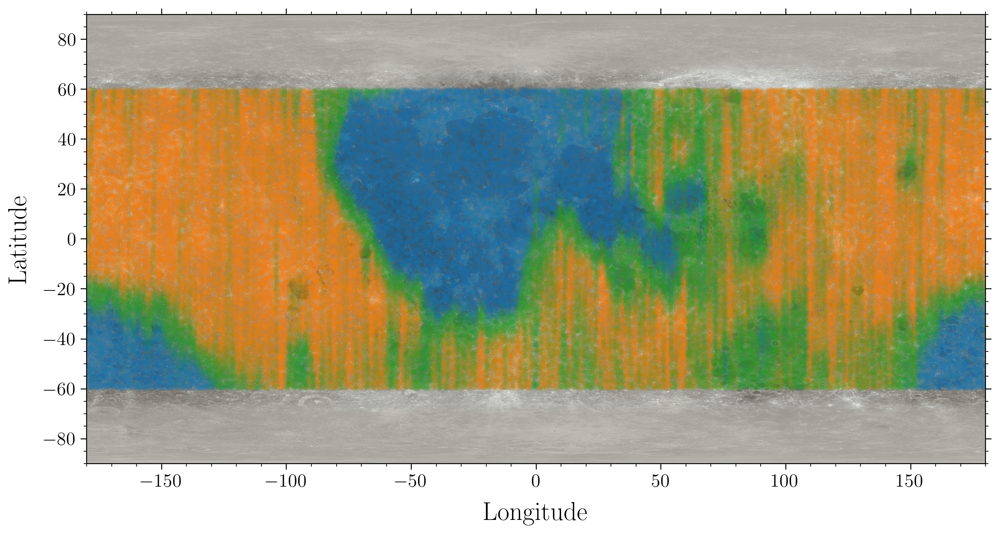

In [6]:
from scipy.optimize import curve_fit

cluster_colors = [f"C{i}" for i in range(3)]
cluster_colors_rgb = [clrs.to_rgb(clr) for clr in cluster_colors]


def linear(x, m, c):
    return m * x + c


def gaussian_cluster(df, num_components_, cluster_colors_):
    # Extract relevant columns
    al_ratio = df["Al_ratio"].values
    lon = df["longitude"].values
    lat = df["latitude"].values
    mg_num = df["Mg_num"].values

    # Stack the data for GMM fitting
    stack = np.vstack([al_ratio, mg_num]).T
    kde = gaussian_kde(stack.T)(stack.T)
    # print(stack.shape)
    # Fit a Gaussian Mixture Model (GMM)
    gmm = GaussianMixture(n_components=num_components_).fit(
        stack
    )  # You can adjust n_components as needed
    print(gmm.means_)
    probabilities = np.sum(
        gmm.predict_proba(stack)[:, :, np.newaxis] * cluster_colors_, axis=1
    )
    # Create a grid for visualization
    x_grid = np.linspace(min(al_ratio) - 0.1, max(al_ratio) + 0.1, 100)
    y_grid = np.linspace(min(mg_num) - 0.1, max(mg_num) + 0.1, 100)
    X, Y = np.meshgrid(x_grid, y_grid)
    grid_points = np.vstack([X.ravel(), Y.ravel()]).T

    # Calculate the density (probabilities) for each point in the grid
    log_density = gmm.score_samples(grid_points)
    density = np.exp(log_density).reshape(X.shape)
    # print(gmm.score_samples(stack).sum())
    # Plot the scatter points for the "red" points
    plt.figure(figsize=(8, 7))
    plt.xlabel("Al/Si")
    plt.ylabel("Mg Number")
    plt.scatter(al_ratio, mg_num, c=kde, s=20, alpha=0.5, cmap="coolwarm")
    x = np.linspace(min(al_ratio), max(al_ratio), 100)
    popt, _ = curve_fit(linear, al_ratio, mg_num)
    R_squared = 1 - np.sum((mg_num - linear(al_ratio, *popt)) ** 2) / np.sum(
        (mg_num - np.mean(mg_num)) ** 2
    )
    print(f"R^2 = {R_squared}")
    # Plot the GMM density as contours
    plt.contour(X, Y, density, levels=5, cmap="coolwarm")
    plt.plot(
        x, linear(x, *popt), "k--", label=f"Mg$\#$ = {popt[0]:.2f}Al/Si + {popt[1]:.2f}"
    )
    plt.legend()
    plt.tight_layout()
    plt.show()

    plt.xlabel("Al/Si")
    plt.ylabel("Mg Number")
    plt.scatter(
        al_ratio,
        mg_num,
        c=probabilities,
        s=20,
        alpha=0.7,
    )
    plt.legend()
    plt.scatter(gmm.means_[:, 0], gmm.means_[:, 1], c="r", s=50, edgecolors="k")
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(12, 8))
    plt.imshow(base_data, extent=(-180, 180, -90, 90), interpolation="nearest", alpha=1)
    plt.scatter(lon, lat, c=probabilities, s=10, alpha=0.07)

    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.tight_layout()
    plt.show()
    plt.close()

    return gmm


gmm = gaussian_cluster(sampled_df, 3, cluster_colors_rgb)

## 5 component clusters

We fit 5 gaussian clusters

[[1.4453439  0.70976293]
 [1.1811149  0.66765946]
 [1.5989538  0.7028747 ]
 [1.7290792  0.684937  ]
 [0.96896774 0.62654674]]
R^2 = 0.1249220364993694


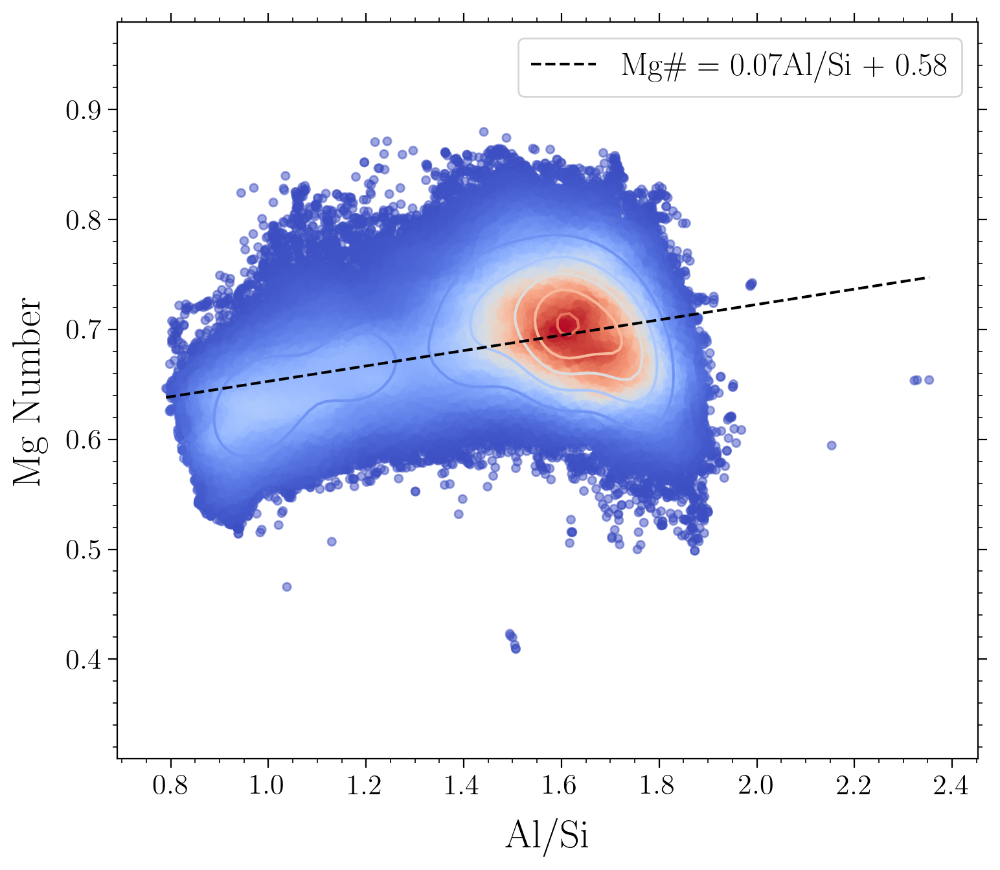

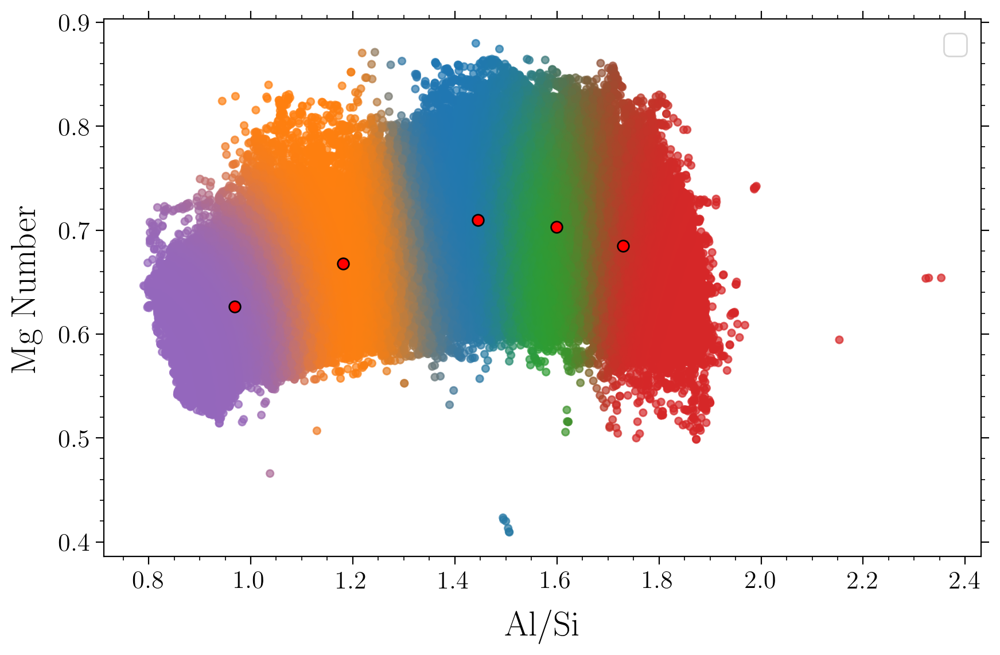

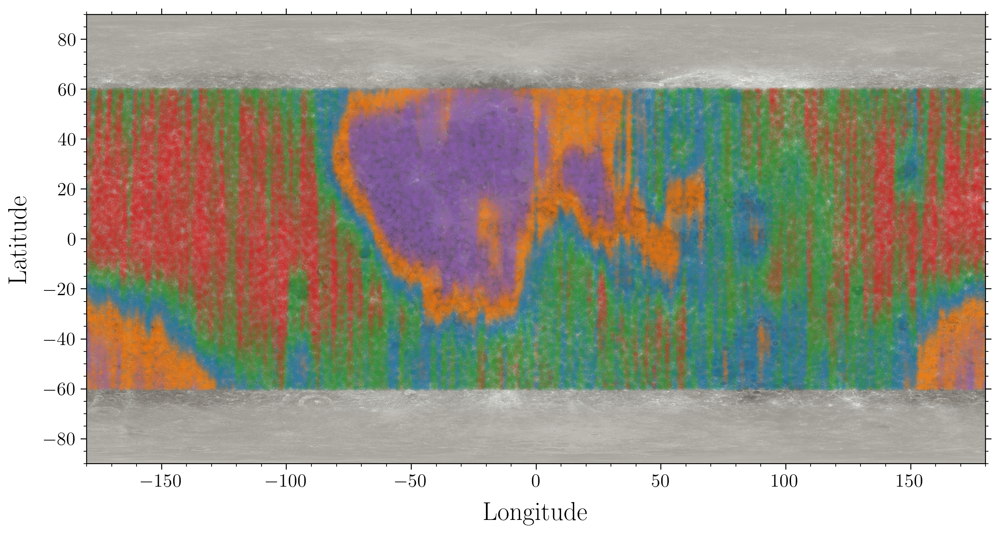

In [7]:
cluster_colors = [f"C{i}" for i in range(5)]
cluster_colors_rgb = [clrs.to_rgb(clr) for clr in cluster_colors]
gmm = gaussian_cluster(sampled_df, 5, cluster_colors_rgb)

In [8]:
def clusters_3d_interactive(df):
    fig = px.scatter_3d(
        df,
        x=[10 * i for i in df["Al_ratio"]],
        y=[10 * i for i in df["Mg_ratio"]],
        z=[10 * i for i in df["FeL_ratio"]],
        color=[f"C{i}" for i in gmm.predict(df[["Al_ratio", "Mg_num"]])],
        opacity=0.5,
        # size=[1 for _ in range(df.shape[0])],
    )
    fig.update_layout(
        scene=dict(
            xaxis_title="Al_ratio", yaxis_title="Mg_ratio", zaxis_title="FeL_ratio"
        )
    )
    fig.show()


clusters_3d_interactive(sampled_df)

In [9]:
def n_gaussian_cluster_3d(df, num_clusters=3):
    # Extract relevant columns
    al_ratio = df["Al_ratio"]
    mg_ratio = df["Mg_ratio"]
    fel_ratio = df["FeL_ratio"]

    # Stack the data for GMM fitting
    stack = np.vstack([al_ratio, mg_ratio, fel_ratio]).T

    # Fit a Gaussian Mixture Model (GMM)
    gmm = GaussianMixture(n_components=num_clusters).fit(stack)
    print(gmm.means_)

    # Predict the cluster for each point in the data
    cluster_labels = gmm.predict(stack)

    # Plot the scatter points with predicted cluster colors using Plotly
    fig = px.scatter_3d(
        df,
        x="Al_ratio",
        y="Mg_ratio",
        z="FeL_ratio",
        color=[f"C{i}" for i in cluster_labels],
        opacity=0.5,
    )
    fig.update_layout(
        scene=dict(
            xaxis_title="Al_ratio", yaxis_title="Mg_ratio", zaxis_title="FeL_ratio"
        )
    )
    fig.show()
    return gmm


gmm_3d = n_gaussian_cluster_3d(sampled_df, 3)

[[1.6747867 1.14919   0.505501 ]
 [1.0781554 1.1830691 0.6612147]
 [1.5069238 1.220924  0.5243574]]


In [10]:
def clusters_3d(df, num_clusters=3):
    al_ratio = df["Al_ratio"]
    lon = df["longitude"]
    lat = df["latitude"]
    mg_ratio = df["Mg_ratio"]
    fel_ratio = df["FeL_ratio"]

    # Stack the data for GMM fitting
    stack = np.vstack([al_ratio, mg_ratio, fel_ratio]).T
    gmm = GaussianMixture(n_components=num_clusters).fit(stack)
    print(gmm.means_)

    cluster_labels = gmm.predict(stack)
    print(cluster_labels)
    print(cluster_labels.shape)
    plt.xlabel(r"Al/Si")
    plt.ylabel("Mg/Si")
    plt.scatter(
        al_ratio,
        mg_ratio,
        c=[f"C{i}" for i in cluster_labels],
        s=20,
        alpha=0.7,
        label=r"Al/Si vs Mg/Si",
        # density=True
    )
    plt.legend()
    plt.show()

    plt.xlabel("Al/Si")
    plt.ylabel(r"Fe$_L$/Si")
    plt.scatter(
        al_ratio,
        fel_ratio,
        c=[f"C{i}" for i in cluster_labels],
        s=20,
        alpha=0.7,
        label=r"Al/Si vs FeL/Si",
        # density=True
    )
    plt.legend()
    plt.show()

    plt.xlabel("Mg/Si")
    plt.ylabel(r"Fe$_L$/Si")
    plt.scatter(
        mg_ratio,
        fel_ratio,
        c=[f"C{i}" for i in cluster_labels],
        s=20,
        alpha=0.7,
        label=r"Mg/Si vs FeL/Si",
        # density=True
    )
    plt.legend()
    plt.show()

    plt.figure(figsize=(12, 8))
    plt.imshow(base_data, extent=(-180, 180, -90, 90), interpolation="nearest", alpha=1)
    plt.scatter(lon, lat, c=[f"C{i}" for i in cluster_labels], s=10, alpha=0.07)

    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.show()
    plt.close()

[[1.6068656  1.1202272  0.45757133]
 [1.1059492  1.1862904  0.6538004 ]
 [1.6134106  1.2628267  0.585415  ]]
[2 0 1 ... 2 0 1]
(200000,)


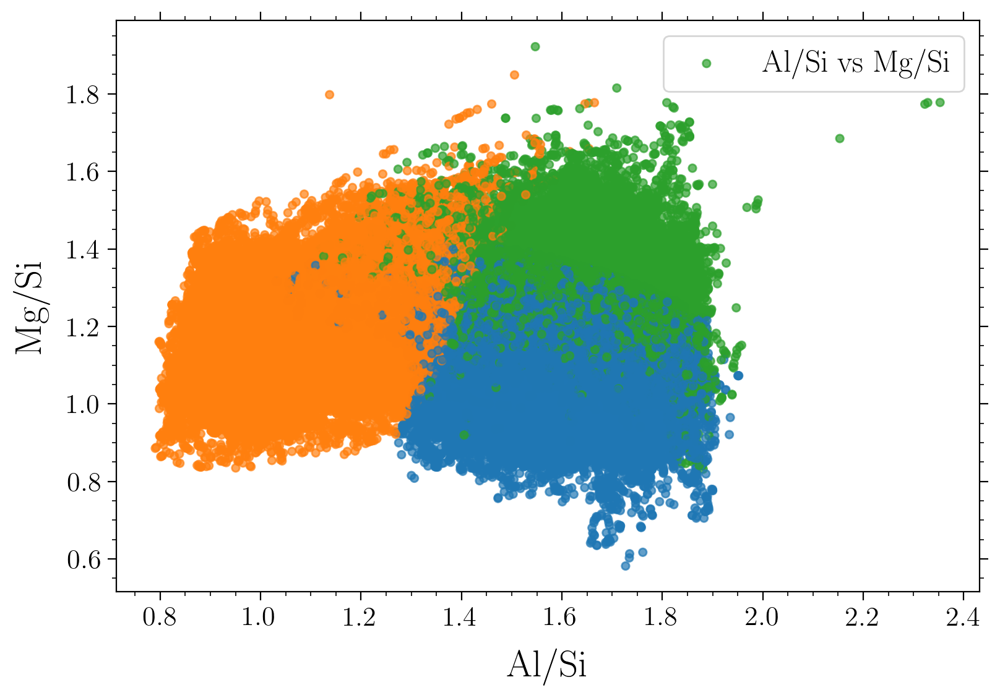

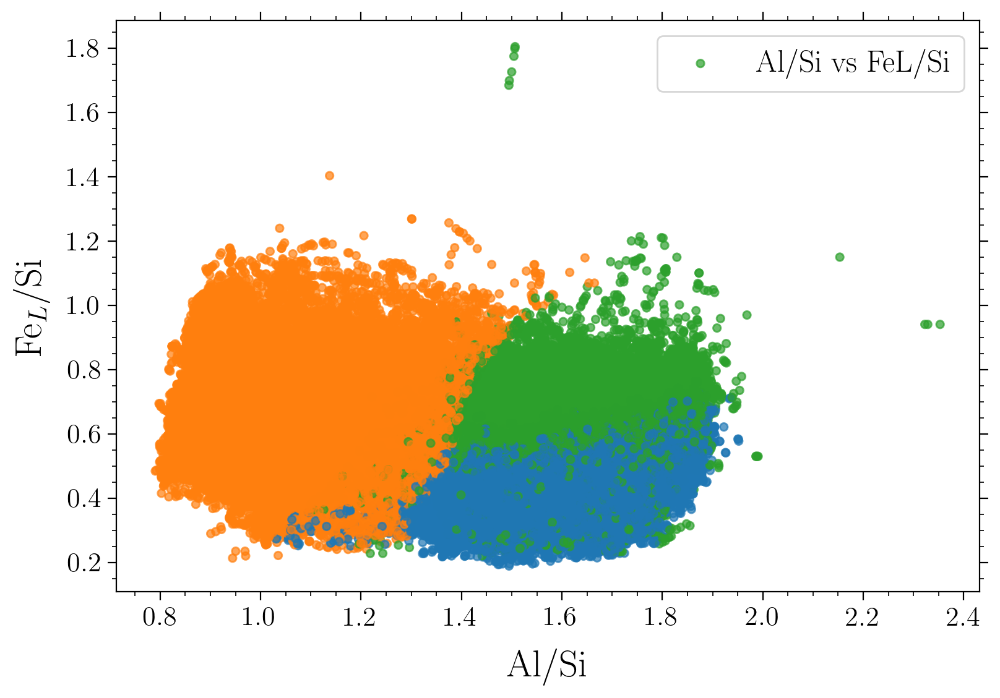

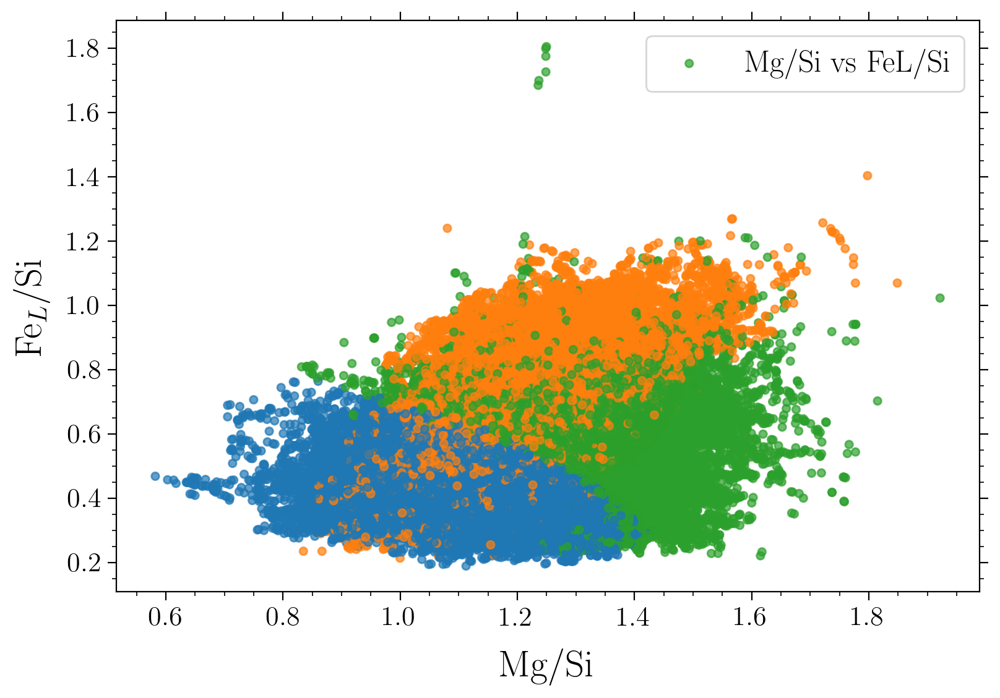

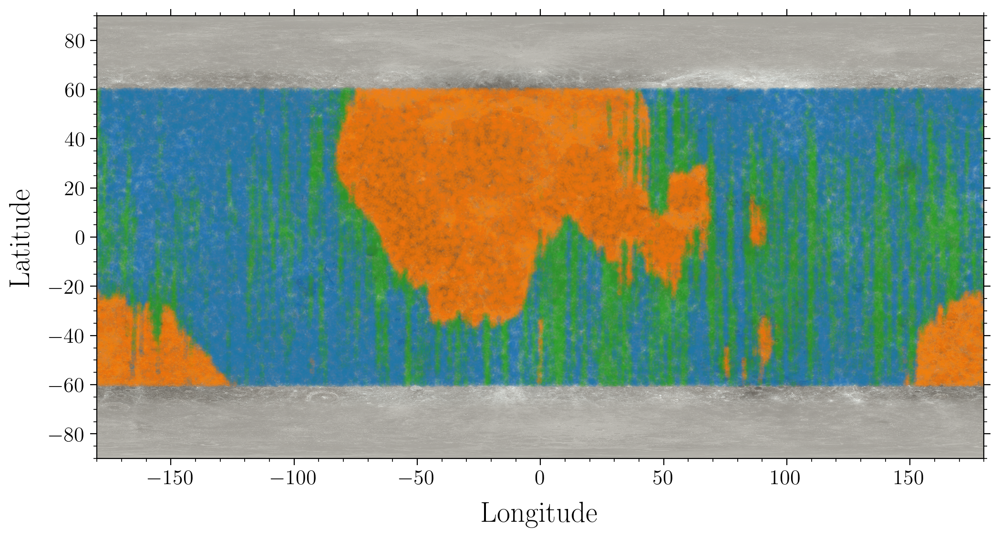

In [11]:
clusters_3d(sampled_df, 3)

[[1.4861295  1.1789154  0.4610585 ]
 [1.6774952  1.108593   0.49541628]
 [1.0790309  1.1846904  0.6628871 ]
 [1.6063576  1.2954682  0.5999174 ]]
[3 1 2 ... 3 1 2]
(200000,)


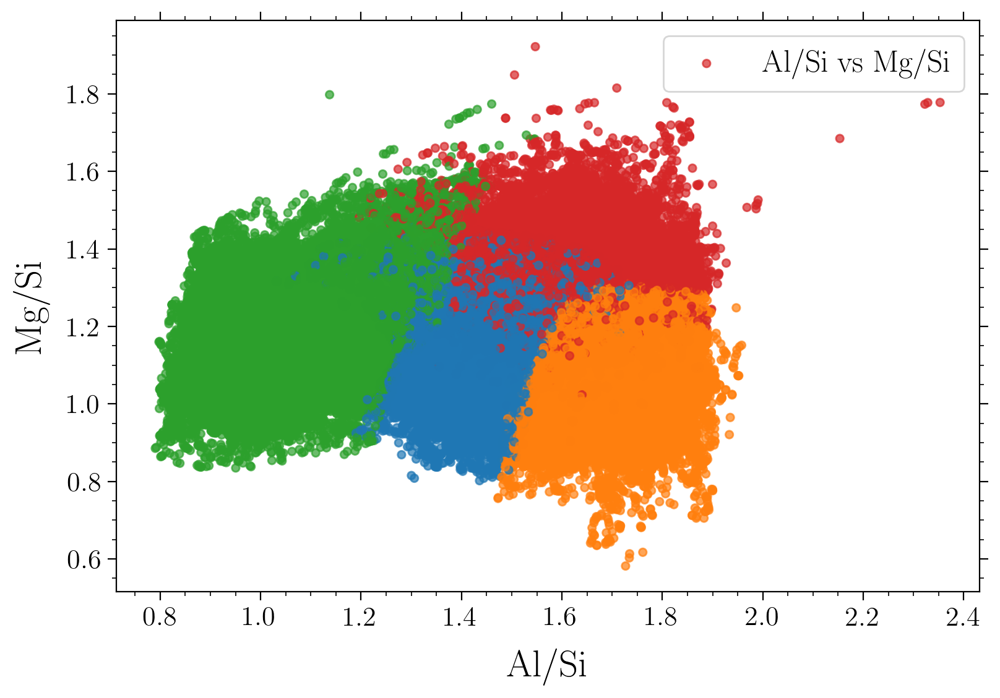

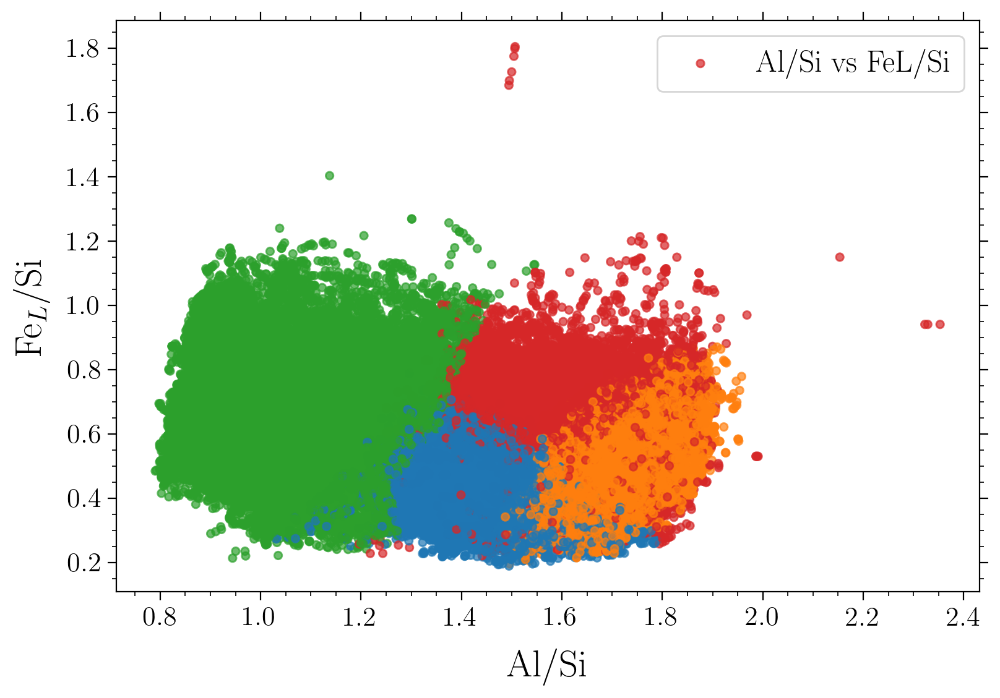

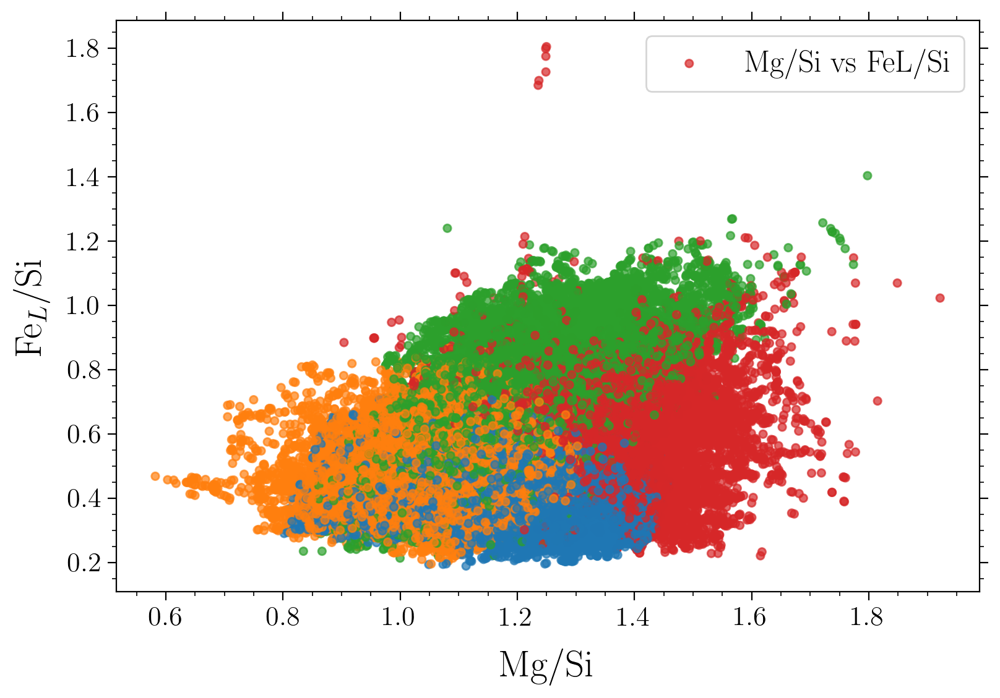

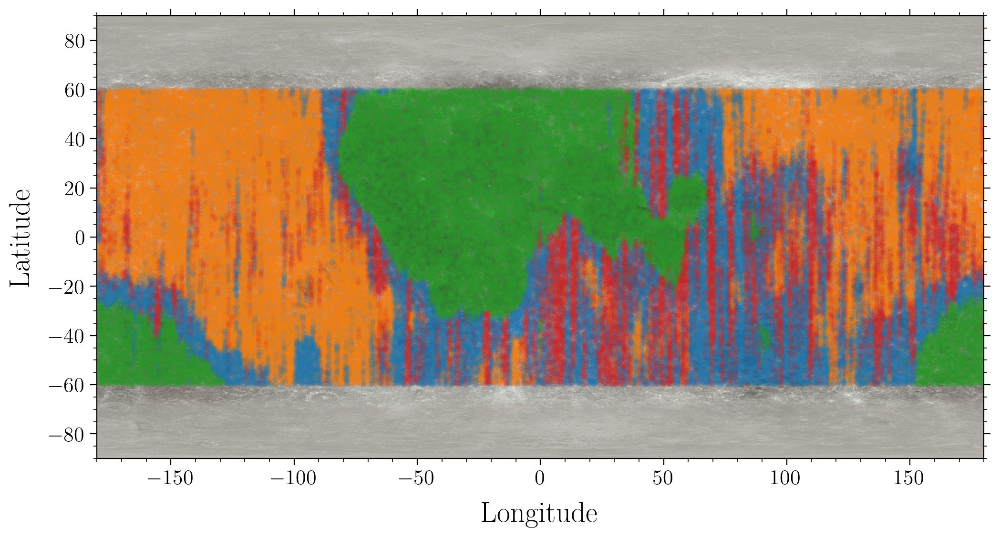

In [12]:
clusters_3d(sampled_df, 4)